In [ ]:
import logging

import numpy as np
import cv2
import skimage

import scipy.ndimage as ndi
import matplotlib.pyplot as plt

from skimage.segmentation import clear_border
from skimage.color import rgb2gray, gray2rgb

from utils.loader import FactoryLoader
from utils.preprocessing import *
from utils.utils import *

In [2]:
DS_PATH = r"C:\Users\gimes\Src\repos\CADx-Project\dataset\binary\train"

In [3]:
if torch.cuda.is_available():
    print("CUDA is available")
    print("Devices:")
    [print(torch.cuda.get_device_name(i)) for i in range(torch.cuda.device_count())]
    print("___")
else:
    print("CUDA is not available")

CUDA is available
Devices:
NVIDIA GeForce RTX 4050 Laptop GPU
___


_____

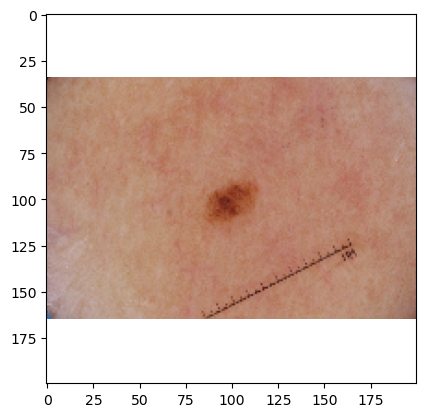

In [4]:
factory = PreprocessingFactory()
factory.normalize2float()
factory.pad2square(np.nan)
factory.resize((200,200))
#factory.gaussian_smoothing()

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

# loader.get_size()
# loader.show_images()
im, lab = loader.get_element_by_id(5)
plt.imshow(im)

In [5]:
class OtsuTh(PreprocessingStep):
    def __init__(self, morph_op=cv2.MORPH_DILATE, kernel_size=5, remove_border=True):
        self.morph_op = morph_op
        self.kernel_size = kernel_size
        self.remove_border = remove_border
    
    def apply(self, image: np.ndarray) -> np.ndarray:
        # Convert to gray
        gray = (rgb2gray(image)*255).astype(np.uint8)

        # Apply otsu-thresholding
        _, otsu_threshold = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
        otsu_threshold = otsu_threshold.astype(bool)   
        
        # Bin. morphological operation for conservation
        se =  cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (self.kernel_size,self.kernel_size))
        otsu_threshold = cv2.morphologyEx(otsu_threshold.astype(float), self.morph_op, se)
        otsu_threshold = otsu_threshold.astype(bool)
        
        # Clear border in case of black rim
        if self.remove_border:
            otsu_threshold = skimage.segmentation.clear_border(otsu_threshold)

        # Apply mask on each channel
        masked = np.dstack([
            (image[:,:,0] * otsu_threshold).astype(np.uint8),
            (image[:,:,1] * otsu_threshold).astype(np.uint8),
            (image[:,:,2] * otsu_threshold).astype(np.uint8)])
 
        return masked

    def get_step_params(self):
        return {"name": "otsu",
                "correction_type": str(self.morph_op),
                "kernel_size": self.kernel_size,
                "remove_border": self.remove_border}

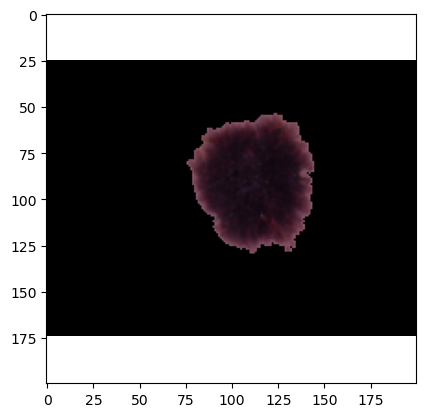

In [6]:
factory = PreprocessingFactory()
factory.gaussian_smoothing(5)
factory.add_preprocessing_step(OtsuTh())

factory.normalize2float()
factory.add_preprocessing_step(Pad2Square(np.nan))
factory.resize((200,200))

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

im, lab = loader.get_element_by_id(0)
plt.imshow(im)
plt.show()

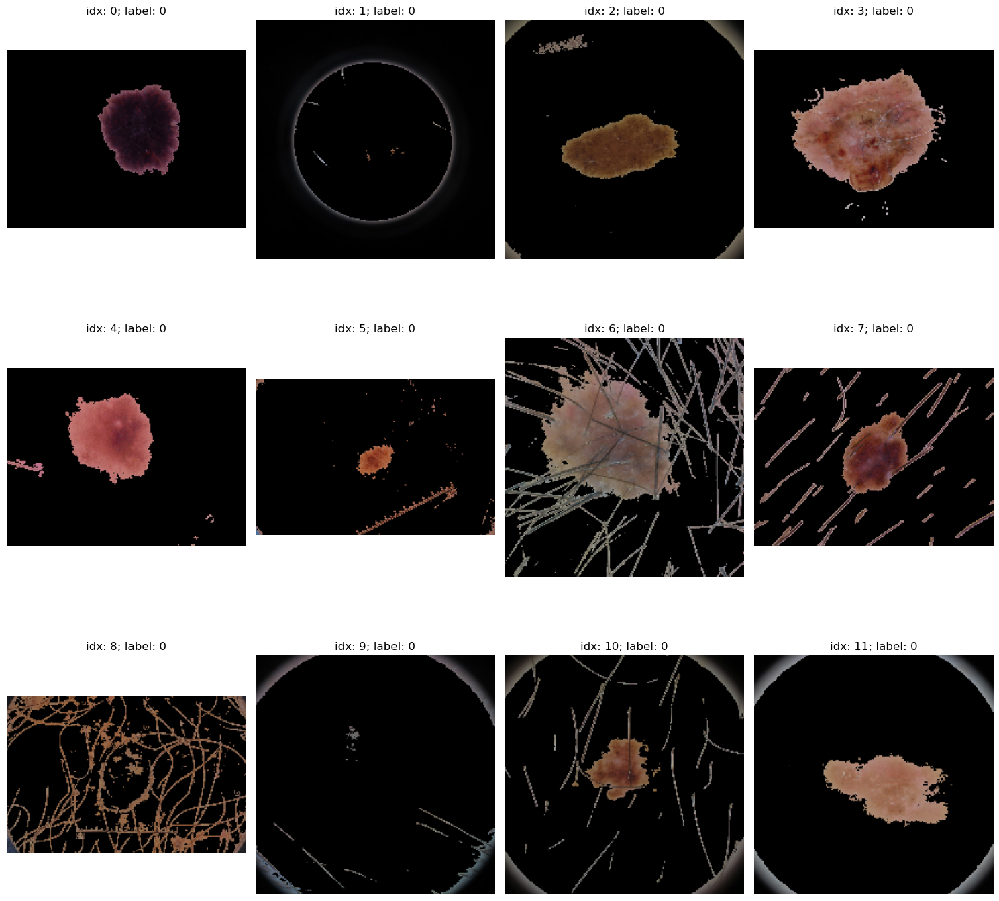

In [7]:
factory = PreprocessingFactory()
factory.add_preprocessing_step(OtsuTh(remove_border=False))
factory.normalize2float()
factory.pad2square(np.nan)
factory.resize((200,200))

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

loader.show_images(12)

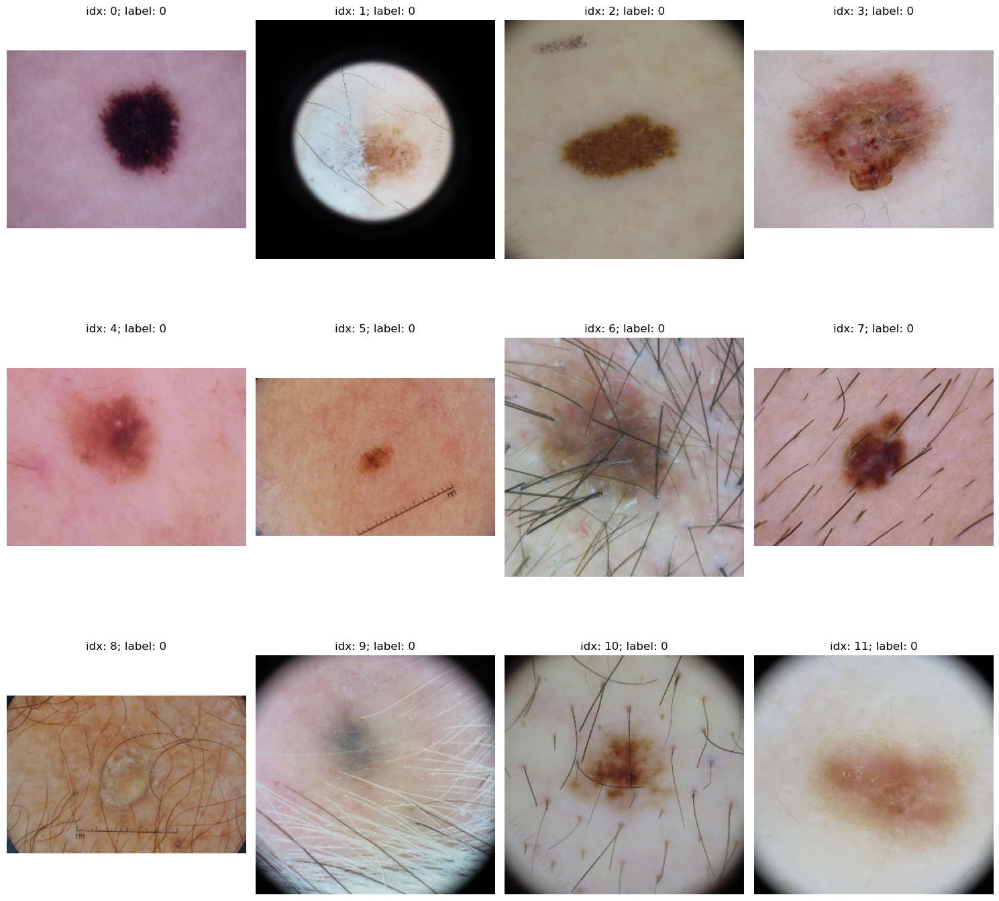

In [8]:
factory = PreprocessingFactory()
factory.normalize2float()
factory.add_preprocessing_step(Pad2Square(np.nan))
factory.resize((300,300))

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

loader.show_images(12)

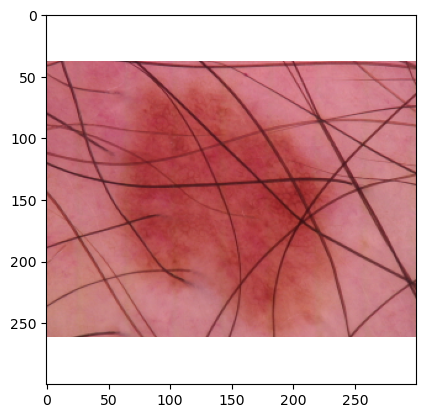

In [9]:
im, lab = loader.get_element_by_id(13)
plt.imshow(im)
plt.show()

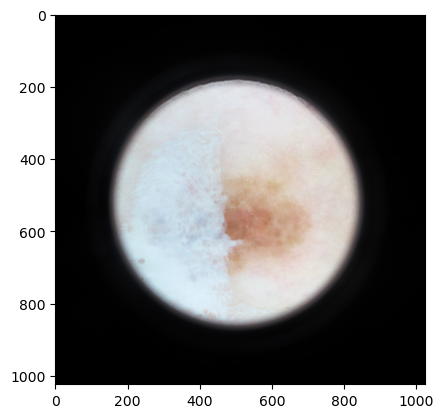

In [10]:
factory = PreprocessingFactory()

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

img, lab = loader.get_element_by_id(1)
img = img

hr1 = HairRemoval(5,8,9)
res1 = hr1.apply(img)

plt.imshow(res1)
plt.show()


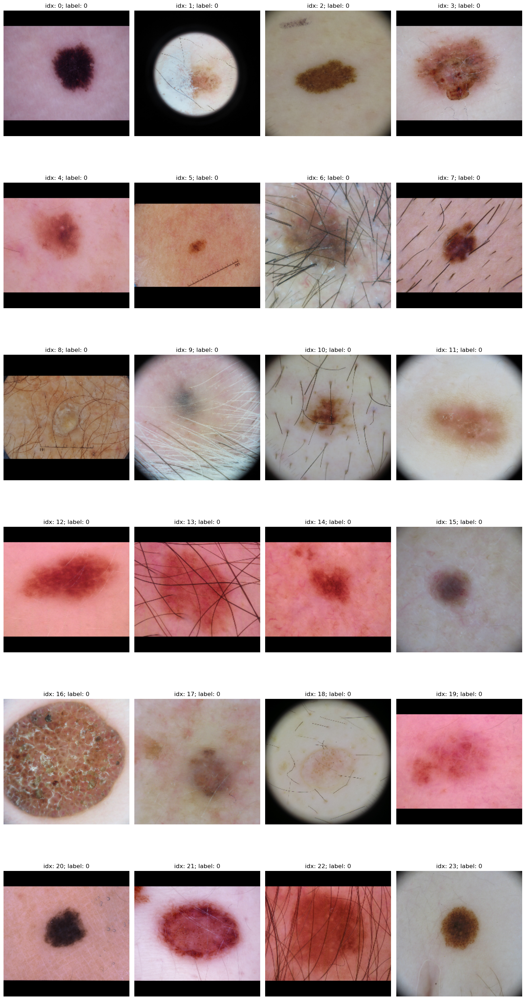

In [11]:
# Adjust this path
factory = PreprocessingFactory()
factory.pad2square()
factory.normalize2float()
factory.resize()
loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)
loader.show_images(24)

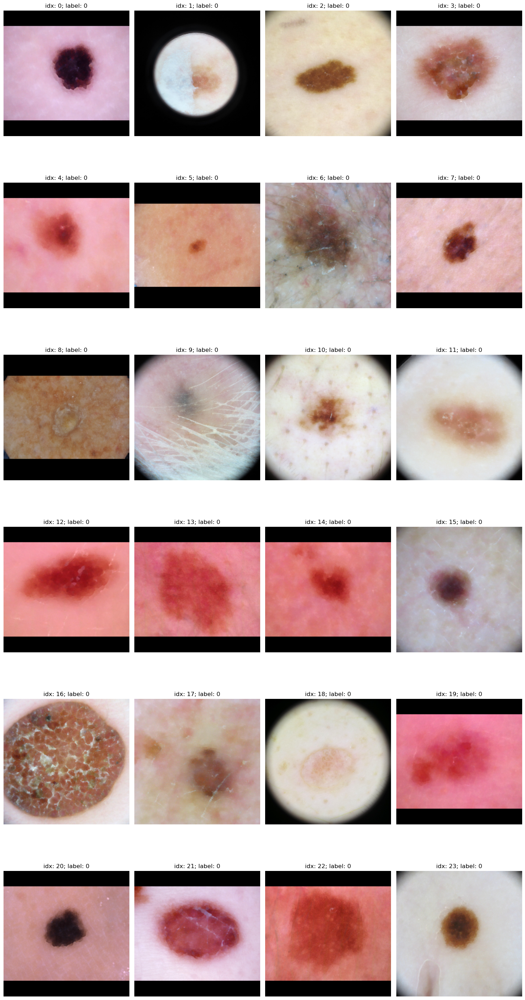

In [12]:
factory = PreprocessingFactory()
factory.add_preprocessing_step(HairRemoval(length=25))
factory.pad2square()
factory.normalize2float()
factory.resize()
loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)
loader.show_images(24)

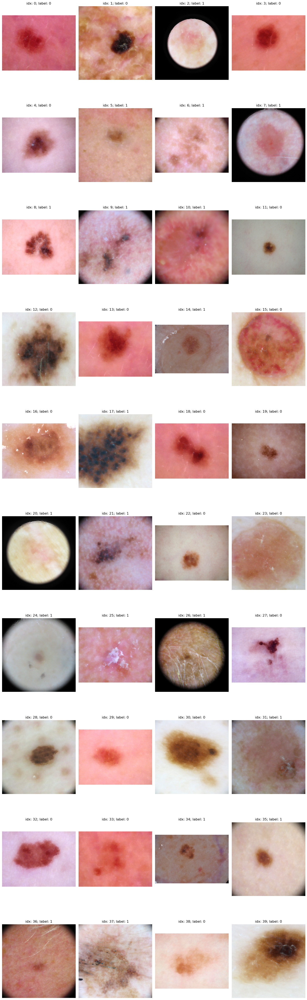

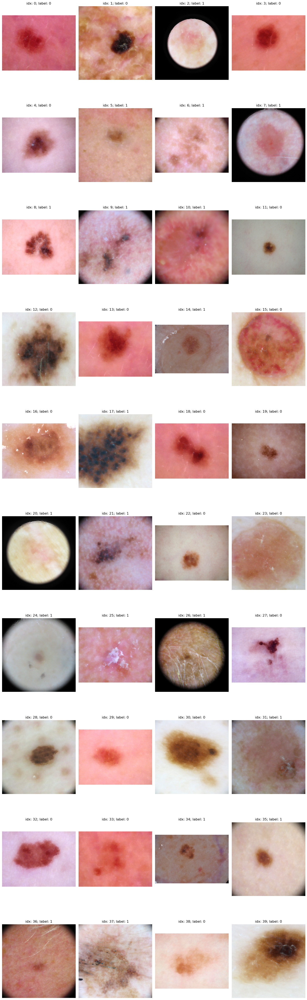

In [13]:
factory = PreprocessingFactory()
factory.add_preprocessing_step(HairRemoval(length=25))
factory.normalize2float()
factory.pad2square(np.nan)
factory.resize()
loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=True)
loader.show_images(40)

factory = PreprocessingFactory()
factory.add_preprocessing_step(HairRemoval(length=25))
factory.normalize2float()
factory.pad2square()
factory.resize()
loader.change_factory(factory)
loader.show_images(40)


In [14]:
import numpy as np
from skimage.exposure import histogram

def otsu_modified(image, ignore_below):
    # Calculate the histogram and bin centers
    hist, bin_centers = histogram(image)

    # Convert pixel values below the threshold to NaN
    bin_centers = np.where(bin_centers < ignore_below, np.nan, bin_centers)

    # Calculate Otsu's threshold using the modified histogram
    total = np.sum(hist)
    current_max, threshold = 0., 0.
    sumB, wB = 0, 0
    sum1 = np.nansum(bin_centers * hist)  # Weighted sum of histogram bins ignoring NaN

    for i in range(len(bin_centers)):
        if np.isnan(bin_centers[i]):
            continue  # Skip NaN values

        wB += hist[i]  # Weight Background
        if wB == 0:  # If there's no background, continue
            continue

        wF = total - wB  # Weight Foreground
        if wF == 0:  # If there's no foreground, stop
            break

        sumB += bin_centers[i] * hist[i]
        mB = sumB / wB  # Mean Background
        mF = (sum1 - sumB) / wF  # Mean Foreground

        # Calculate Between Class Variance
        varBetween = wB * wF * (mB - mF) ** 2

        # Check if new maximum found
        if varBetween > current_max:
            current_max = varBetween
            threshold = bin_centers[i]

    return threshold

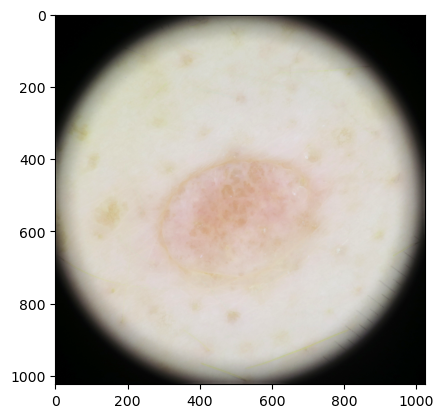

0.94319963


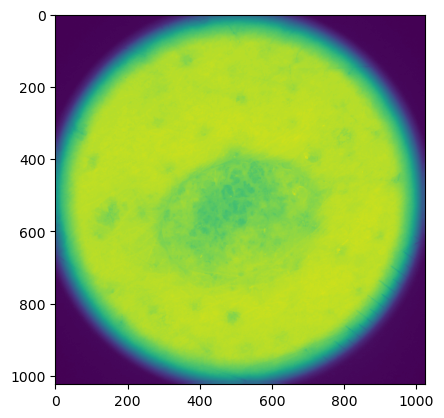

In [15]:
import scipy

factory = PreprocessingFactory()
factory.add_preprocessing_step(HairRemoval())
factory.normalize2float()
factory.pad2square(np.nan)

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

im, lab = loader.get_element_by_id(18)

plt.imshow(im)
plt.show()
np.unique(im)

th = otsu_modified(rgb2gray(im), 0.20)
print(th)


thresholded = norm(rgb2gray(im), np.uint8)
thresholded[thresholded<th] = 0

plt.imshow(thresholded)
plt.show()

0.44114423


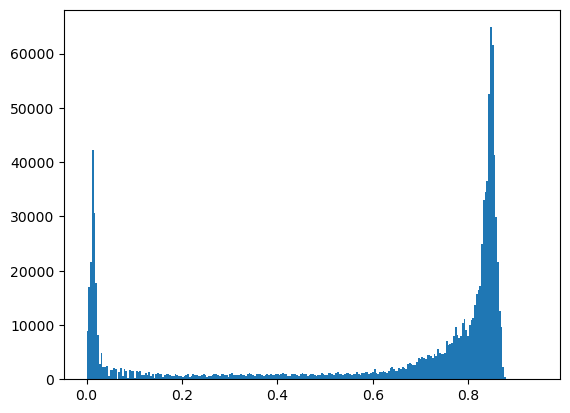

1048576
789401


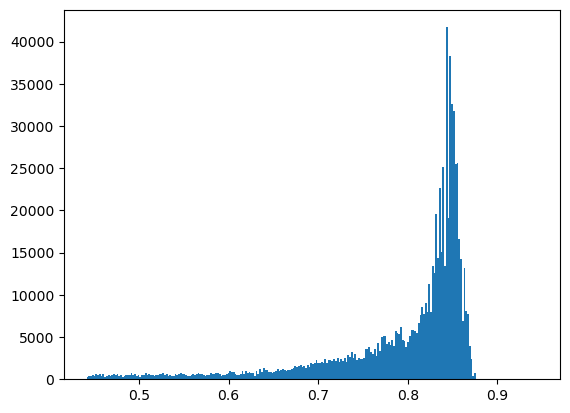

In [16]:
im, lab = loader.get_element_by_id(18)

th = otsu_modified(rgb2gray(im), 0.0020)
print(th)
thresholded = (rgb2gray(im))
thresholded[thresholded < th] = 0


plt.hist((rgb2gray(im)).flatten(), bins=256)
plt.show()

nand = (thresholded).copy()
nand[(nand < th)] = 0

res = nand.copy()
print(res.size)

res = nand[nand!=0]
print(res.size)

plt.hist(res.flatten(), bins=256)
plt.show()

In [17]:
mask = (rgb2gray(im)>th).astype(bool)
mask = scipy.ndimage.binary_fill_holes(mask)

nonzero = np.count_nonzero(mask)
pix = mask.size
if nonzero:
    print("Total pix")
    print(pix)
    print("Mask nonzeros")
    print(nonzero)
    print("Mask zeros")
    print(pix-nonzero)
    print("Ratio")
    print(nonzero/pix)

mask_rgb = np.dstack((mask, mask, mask))
masked = mask_rgb * im
plt.imshow(masked)
plt.show()

plt.hist.

SyntaxError: invalid syntax (3874612618.py, line 21)

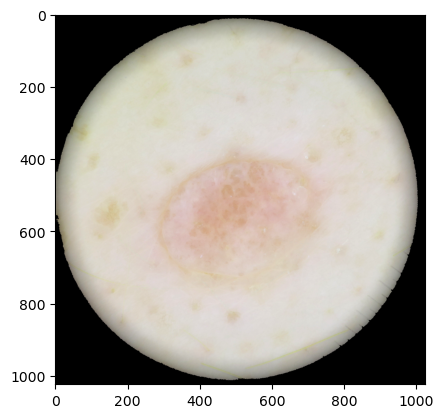

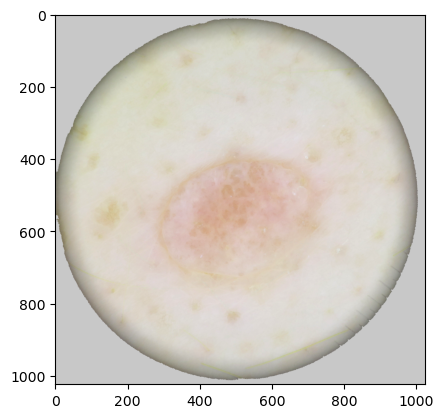

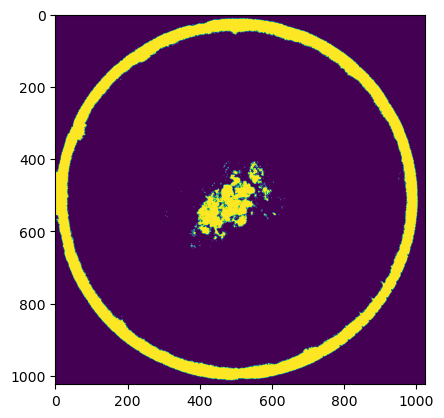

In [18]:
plt.imshow(masked)
plt.show()

masked_inv = masked.copy()
masked_inv[masked == 0] = np.mean(masked[masked!=0])

plt.imshow(masked_inv)
plt.show()

_, th = cv2.threshold(norm(rgb2gray(masked_inv), np.uint8), 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

th.shape
plt.imshow(th)
plt.show()


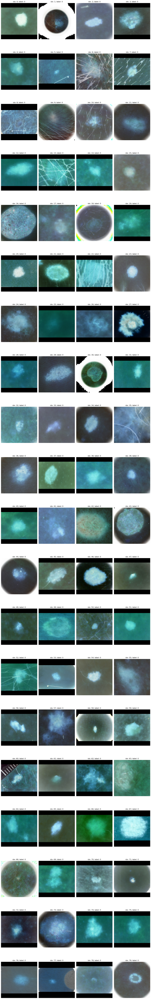

In [21]:
class DoubleOtsu(PreprocessingStep):
    # TODO: NOT GOOOOD!!!!
    def __init__(self, ):
        pass
        
    def apply(self, image: np.ndarray) -> np.ndarray:

        th = otsu_modified(rgb2gray(image), 0.010)
        
        
        mask = (rgb2gray(image)>th).astype(bool)
        mask = scipy.ndimage.binary_fill_holes(mask)

        mask_rgb = np.dstack((mask, mask, mask))
        masked = mask_rgb * image
        
        masked_inv = masked.copy()
        nonzero = np.count_nonzero(mask)
        pix = mask.size
        if nonzero:
            print("Total pix")
            print(pix)
            print("Mask nonzeros")
            print(nonzero)
            print("Mask zeros")
            print(pix-nonzero)
            print("Ratio")
            print(nonzero/pix)
        
        if nonzero/pix < 0.95:
            masked_inv[masked == 0] = np.mean(masked[masked!=0])
        
        _, th = cv2.threshold(norm2int(rgb2gray(masked_inv)), 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
        

        return gray2rgb(th).astype(np.uint8)

    def get_step_params(self):
        return {"name": ""}
    
factory = PreprocessingFactory()
factory.add_preprocessing_step(HairRemoval())
#factory.add_preprocessing_step(DoubleOtsu())
factory.pad2square(np.nan)
factory.resize()
factory.normalize2float()

loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)
loader.show_images(80)


In [22]:
class DoubleOtsu(PreprocessingStep):
    # TODO: NOT GOOOOD!!!!
    def __init__(self, ):
        pass

    def apply(self, image: np.ndarray) -> np.ndarray:

        th = otsu_modified(rgb2gray(image), 0.0010)
        print(th)
        result = image.copy()

        result[result<th] = 0

        return result

    def get_step_params(self):
        return {"name": ""}


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..243.0].


0.38746138403799024


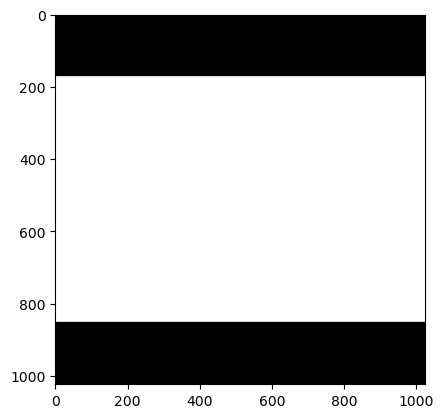

In [23]:
factory = PreprocessingFactory()
factory.normalize2float()

factory.add_preprocessing_step(HairRemoval())
factory.add_preprocessing_step(DoubleOtsu())
factory.pad2square(np.nan)
loader = FactoryLoader(DS_PATH, factory=factory, batch_size=12, percentage=5, shuffle=False)

im, lab = loader.get_element_by_id(77)


#_, th = cv2.adaptiveThreshold()

plt.imshow(im)